# Generating _in silico_ tissue from full CODEX dataset 

## Process segmentation mask

In [1]:
import matplotlib.pyplot as plt
import matplotlib
#import skimage.io as io
import numpy as np

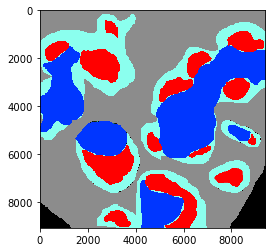

In [2]:
seg = io.imread('/Users/ethan/Downloads/BALBc-1_map.tif')
plt.imshow(seg)

In [3]:
from skimage.color import rgb2gray
from sklearn.cluster import KMeans
from sklearn.metrics import pairwise_distances_argmin
from sklearn.datasets import load_sample_image
from sklearn.utils import shuffle

n_colors = 5

seg_mask = np.array(seg, dtype = np.float64) / 255
w,h,d = original_shape = tuple(seg_mask.shape)
assert d == 3

image_array = np.reshape(seg_mask, (w*h, d))

In [ ]:
image_array_sample = shuffle(image_array, random_state=0)[:1000]
kmeans = KMeans(n_clusters=n_colors, random_state=0).fit(image_array_sample)

In [ ]:
labels = kmeans.predict(image_array)

In [ ]:
codebook_random = shuffle(image_array, random_state=0)[:n_colors]
labels_random = pairwise_distances_argmin(codebook_random,
                                          image_array,
                                          axis=0)

In [ ]:
def recreate_image(codebook, labels, w, h):
    """Recreate the (compressed) image from the code book & labels"""
    d = codebook.shape[1]
    image = np.zeros((w, h, d))
    label_idx = 0
    for i in range(w):
        for j in range(h):
            image[i][j] = codebook[labels[label_idx]]
            label_idx += 1
    return image

In [ ]:
plt.imshow(recreate_image(kmeans.cluster_centers_, labels, w, h))

In [ ]:
seg_map_clustered = recreate_image(kmeans.cluster_centers_, labels, w, h)

In [ ]:
seg_map_clustered_gray = rgb2gray(seg_map_clustered)

In [ ]:
a = np.unique(seg_map_clustered_gray)

In [ ]:
plt.imshow(seg_map_clustered_gray)

In [ ]:
seg_map_clustered_gray[seg_map_clustered_gray == a[0]] = 0
seg_map_clustered_gray[seg_map_clustered_gray == a[1]] = 1
seg_map_clustered_gray[seg_map_clustered_gray == a[2]] = 2
seg_map_clustered_gray[seg_map_clustered_gray == a[3]] = 3
seg_map_clustered_gray[seg_map_clustered_gray == a[4]] = 4

In [8]:
#np.save('./spleen_data/for_paper/BALB1C_seg_mask.npy', seg_map_clustered_gray)
seg_mask = np.load('./spleen_data/for_paper/BALB1C_seg_mask.npy')

## Create Cell ID Position Matrix

In [9]:
cell_positions = np.load('./spleen_data/for_paper/cell_ID_positions.npy')

In [10]:
max_x = max(cell_positions[:, 1])
max_y = max(cell_positions[:, 2])
print(max_x, max_y)

9375 9041


In [11]:
arr = np.zeros((seg_mask.shape[0], seg_mask.shape[1]),dtype=np.int)
arr.shape

(9072, 9408)

In [12]:
for i in range(0, cell_positions.shape[0]):
    cell_id =  cell_positions[i, 0]
    x = cell_positions[i, 1]-1
    y = cell_positions[i, 2]-1
    
    arr[y, x] = cell_id

In [13]:
min_x = min(cell_positions[:, 1])
min_y = min(cell_positions[:, 2])
print(min_x, min_y)

1 4


In [11]:
np.where(arr != 0)

(array([   3,    3,    3, ..., 9039, 9039, 9040]),
 array([6162, 8226, 8570, ..., 2276, 5014, 4696]))

In [12]:
arr[3,8226]

640634

In [13]:
seg_mask.shape

(9072, 9408)

In [14]:
arr.shape

(9072, 9408)

Key:
    1 - B-Follicle
    2 - PALS
    3 - Red Pulp 
    4 - Marginal Zone
    

In [14]:
b_follicle_ids = arr[(seg_mask == 1) & (arr != 0)]
pals_ids = arr[(seg_mask == 2) & (arr != 0)]
red_pulp_ids = arr[(seg_mask == 3) & (arr != 0)]
marginal_zone_ids = arr[(seg_mask == 4) & (arr != 0)]

## calculate spatial parameters in zones

In [2]:
import pandas as pd
import networkx as nx
import spatialpower.neighborhoods.permutationtest as perm_test

In [18]:
df = pd.read_pickle('./spleen_data/for_paper/balbc1_minimal_df.pkl')

In [19]:
id_zone_dict = dict()

for i in b_follicle_ids:
    id_zone_dict[i] = 1
for i in pals_ids:
    id_zone_dict[i] = 2
for i in red_pulp_ids:
    id_zone_dict[i] = 3
for i in marginal_zone_ids:
    id_zone_dict[i] = 4

In [20]:
def assign_zone_id(x):
    try:
        res = id_zone_dict[x]
    except KeyError:
        res = 0
    
    return res

In [21]:
df['zone_id'] = df['source_id'].apply(assign_zone_id)

<Figure size 432x288 with 0 Axes>

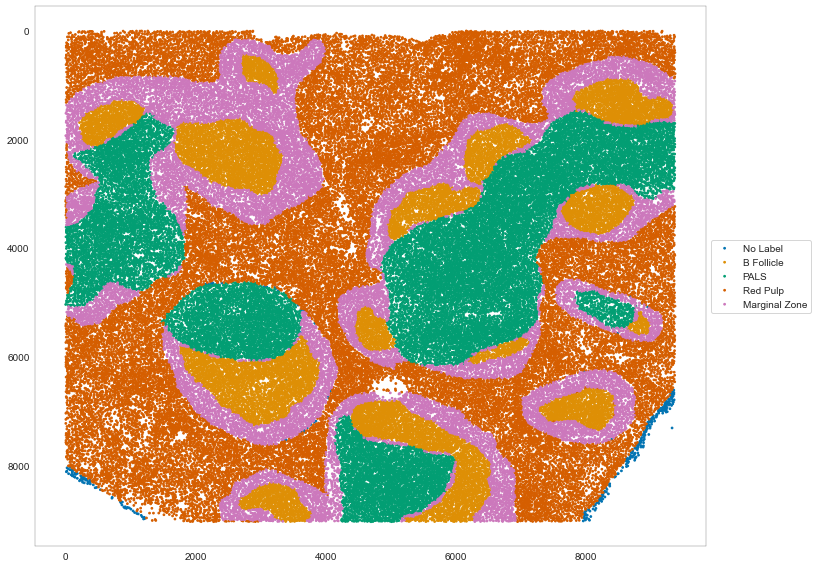

In [54]:
#quick plot by zone. 
import matplotlib
from matplotlib import cm, colors
import matplotlib.pyplot as plt

matplotlib.rcParams.update({'axes.linewidth': 0.25,
                            'xtick.major.size': 2,
                            'xtick.major.width': 0.25,
                            'ytick.major.size': 2,
                            'ytick.major.width': 0.25,
                            'pdf.fonttype': 42,
                            'font.sans-serif': 'Arial'})

#cmap = cm.get_cmap('nipy_spectral', 5)
cmap = sns.color_palette(palette = 'colorblind', n_colors=5)
'''color_list = []
for i in range(cmap.N):
    rgb = cmap(i)[:3] # will return rgba, we take only first 3 so we get rgb
    #print(colors.rgb2hex(rgb))
    color_list.append(colors.rgb2hex(rgb))'''
    
reg_color_dict = dict(zip([i for i in range(0,5)], cmap))
df['reg_color'] = df['zone_id'].apply(lambda x: reg_color_dict[x])

plt.clf()
fig, (ax1) = plt.subplots(1,1, figsize = (10,8))

for j in range(0,5):
    df_r = df[df['zone_id'] == j]
    
    if j == 0:
        label=r'No Label'
    elif j == 1:
        label = r'B Follicle'
    elif j == 2:
        label = r'PALS'
    elif j == 3:
        label = r'Red Pulp'
    elif j == 4:
        label = r'Marginal Zone'
    ax1.scatter(df_r['X1_adjusted'], df_r['Y1_adjusted'], color=df_r['reg_color'], marker='o', s=3, label = label)
    #ax1.set_title('colored by region label')
#ax1.set_ylim(7000,900)

plt.gca().invert_yaxis()
# Shrink current axis by 20%
box = ax1.get_position()
ax1.set_position([box.x0, box.y0, box.width * 0.8, box.height])

# Put a legend to the right of the current axis
ax1.legend(loc='center left', bbox_to_anchor=(1, 0.5))


plt.savefig('./spleen_data/figures/balbc1_regions.pdf')
plt.tight_layout()
plt.show()

In [22]:
def build_graphs(df):
    pos = []
    for i in df.index.tolist():
        x = df.loc[i, 'X1_adjusted']
        y = df.loc[i, 'Y1_adjusted']
        p = [x, y]
        pos.append(p)

    position_dict = dict(zip(df['source_id'].tolist(),pos))

    edgelist = []
    for i in df.index.tolist():
        source = df.loc[i, "source_id"]
        sink = df.loc[i, "sink_id"]
        edgelist.append((source, sink))
    
    return pos, edgelist

In [23]:
b_follicle_df = df[df['zone_id'] == 1]
pals_df = df[df['zone_id'] == 2]
red_pulp_df = df[df['zone_id'] == 3]
marginal_zone_df = df[df['zone_id'] == 4]

In [24]:
b_follicle_pos, b_follicle_edgelist = build_graphs(df[df['zone_id'] == 1])
pals_pos, pals_edgelist = build_graphs(df[df['zone_id'] == 2])
red_pulp_pos, red_pulp_edgelist = build_graphs(df[df['zone_id'] == 3])
marginal_zone_pos, marginal_zone_edgelist = build_graphs(df[df['zone_id'] == 4])

In [25]:
b_follicle_graph = nx.from_edgelist(b_follicle_edgelist)
pals_graph = nx.from_edgelist(pals_edgelist)
red_pulp_graph = nx.from_edgelist(red_pulp_edgelist)
marginal_zone_graph = nx.from_edgelist(marginal_zone_edgelist)

In [6]:
def build_assignment_matrix(attribute_dict, n_cell_types):
    data = list(attribute_dict.items())
    data = np.array(data)  # Assignment matrix

    B = np.zeros((data.shape[0], n_cell_types))  # Empty matrix

    for i in range(0, data.shape[0]):
        t = data[i, 1]
        B[i, t] = 1

    return B

def run_test(results_path, A, B, H_gt, size, n_jobs, trials, plot, graph, graph_id, threshold):
    '''
    Runs the permutation test, and calculates signficant interaction pairs.

    Parameters
    ----------
        results_path: str, the root results dir
        size : int, size of graph to calculate.
        n_jobs: int, number of parallel jobs to spawn
        trials: int, number of shuffles in empirical distribution
        plot : bool, generate histogram of each pairwise relation if True.

    Returns
    -------
        None
    '''
    # Make results dir
    try:
        os.mkdir(results_path)
    except OSError as exc:
        if exc.errno != errno.EEXIST:
            raise
        pass

    # Perform calculations.
    results = []
    if graph_id == None:
        out_dir = results_path + str(size) + '_cells/'
    else:
        out_dir = results_path + str(size) + '_cells_' + str(graph_id) + '/'

    try:
        os.mkdir(out_dir)
    except OSError as exc:
        if exc.errno != errno.EEXIST:
            raise
        pass
    
    n_cell_types = B.shape[1]
    args = (A, B, size, graph, n_cell_types)
    arg_list = [args for i in range(0, trials)]
    results = Parallel(n_jobs=n_jobs, verbose=1, backend="sequential")(
        delayed(perm_test.permutation_test_trial_wrapper)(args) for args in arg_list)
    #parse_results(results, size, out_dir)

    # Process results

    '''# size_list = []
    result_list = []

    file_list = glob(out_dir + '*.npy')
    for f in file_list:
        arr = np.load(f)
        # size_list.append(size)
        result_list.append(arr)'''

    arr = np.dstack(results)  # stack into a 3-D array
    n_types = arr.shape[0]

    enriched_pairs = []
    depleted_pairs = []

    for i in range(0, n_types):
        for j in range(0, n_types):
            ground_truth_score = H_gt[i, j]
            emp_dist = arr[i, j, :]
            indices, = np.where(emp_dist < ground_truth_score)
            p = (len(emp_dist) - len(indices) + 1) / (len(emp_dist) + 1)
            if p <= threshold:
                enriched_pairs.append([i, j, p])
            elif p >= 1 - threshold:
                depleted_pairs.append([i, j, p])

            # Visualize empirical distribution
            if plot == True:
                plt.clf()
                # sns.set(style = 'white')
                plt.hist(arr[2, 2, :], color='k')
                plt.xlim(0, 1)
                plt.xlabel("Probability of Interaction between " + str(i) + " and " + str(j))
                plt.ylabel("Count")
                plt.savefig(out_dir + "distplot_" + str(i) + "_" + str(j) + ".pdf")

    # Write results matrix.
    np.save(out_dir + "enriched_pairs.npy", np.array(enriched_pairs))
    np.save(out_dir + "depleted_pairs.npy", np.array(depleted_pairs))

    return

def run_test_nosave(A, B, H_gt, size, n_jobs, trials, graph, threshold):
    '''
    Runs the permutation test, and calculates signficant interaction pairs.

    Parameters
    ----------
        size : int, size of graph to calculate.
        n_jobs: int, number of parallel jobs to spawn
        trials: int, number of shuffles in empirical distribution
        plot : bool, generate histogram of each pairwise relation if True.

    Returns
    -------
        enriched_pairs  :   array-like
        depleted_pairs  :   array-like
    '''
   
    n_cell_types = B.shape[1]
    args = (A, B, size, graph, n_cell_types)
    arg_list = [args for i in range(0, trials)]
    results = Parallel(n_jobs=n_jobs, verbose=1, backend="sequential")(
        delayed(perm_test.permutation_test_trial_wrapper)(args) for args in arg_list)
    #parse_results(results, size, out_dir)

    arr = np.dstack(results)  # stack into a 3-D array
    n_types = arr.shape[0]

    enriched_pairs = []
    depleted_pairs = []

    for i in range(0, n_types):
        for j in range(0, n_types):
            ground_truth_score = H_gt[i, j]
            emp_dist = arr[i, j, :]
            indices, = np.where(emp_dist < ground_truth_score)
            p = (len(emp_dist) - len(indices) + 1) / (len(emp_dist) + 1)
            if p <= threshold:
                enriched_pairs.append([i, j, p])
            elif p >= 1 - threshold:
                depleted_pairs.append([i, j, p])

    # Write results matrix.
    np.save(out_dir + "enriched_pairs.npy", np.array(enriched_pairs))
    np.save(out_dir + "depleted_pairs.npy", np.array(depleted_pairs))

    return enriched_pairs, depleted_pairs

def parse_pair_arr_to_tuple(arr):
    
    if len(arr) != 0: 
        enriched_pairs = list(arr[:,0:2].astype(int))
        x = []
        for i in enriched_pairs:
            x.append((i[0], i[1]))

        return x
    else:
        return []

### B Follicle

In [27]:
#clean out cross border edges. 
for i in list(b_follicle_graph.nodes):
    if i not in b_follicle_ids:
        b_follicle_graph.remove_node(i)

In [28]:
attribute_dict = dict(zip(b_follicle_df['source_id'], b_follicle_df['rev_cell_type']))
A = nx.convert_matrix.to_scipy_sparse_matrix(b_follicle_graph)
B = build_assignment_matrix(attribute_dict, 27)
p_bfollicle = np.divide(np.sum(B, axis=0), A.shape[0])
H_bfollicle = perm_test.calculate_neighborhood_distribution_sparse(A, B)

/Users/ethan/Dropbox (MIT)/Lab/spatial-data-generation/circle_packing/spatialpower/neighborhoods/permutationtest.py:170: RuntimeWarning: divide by zero encountered in true_divide
  aux1 = 1/edge_count_by_node
/Users/ethan/Dropbox (MIT)/Lab/spatial-data-generation/circle_packing/spatialpower/neighborhoods/permutationtest.py:177: RuntimeWarning: divide by zero encountered in true_divide
  aux2 = 1/cell_type_counts


In [29]:
np.save('./spleen_data/for_paper/p_bfollicle_balbc1.npy', p_bfollicle)
np.save('./spleen_data/for_paper/H_bfollicle_balbc1.npy', H_bfollicle)

### PALS

In [30]:
#clean out cross border edges. 
for i in list(pals_graph.nodes):
    if i not in pals_ids:
        pals_graph.remove_node(i)

In [31]:
attribute_dict = dict(zip(pals_df['source_id'], pals_df['rev_cell_type']))
A = nx.convert_matrix.to_scipy_sparse_matrix(pals_graph)
B = build_assignment_matrix(attribute_dict, 27)
p_pals = np.divide(np.sum(B, axis=0), A.shape[0])
H_pals = perm_test.calculate_neighborhood_distribution_sparse(A, B)

In [32]:
np.save('./spleen_data/for_paper/p_pals_balbc1.npy', p_pals)
np.save('./spleen_data/for_paper/H_pals_balbc1.npy', H_pals)

### Red Pulp

In [33]:
#clean out cross border edges. 
for i in list(red_pulp_graph.nodes):
    if i not in red_pulp_ids:
        red_pulp_graph.remove_node(i)

In [34]:
attribute_dict = dict(zip(red_pulp_df['source_id'], red_pulp_df['rev_cell_type']))
A = nx.convert_matrix.to_scipy_sparse_matrix(red_pulp_graph)
B = build_assignment_matrix(attribute_dict, 27)
p_red_pulp = np.divide(np.sum(B, axis=0), A.shape[0])
H_red_pulp = perm_test.calculate_neighborhood_distribution_sparse(A, B)

In [35]:
np.save('./spleen_data/for_paper/p_redpulp_balbc1.npy', p_red_pulp)
np.save('./spleen_data/for_paper/H_redpulp_balbc1.npy', H_red_pulp)

### Marginal Zone

In [36]:
#clean out cross border edges. 
for i in list(marginal_zone_graph.nodes):
    if i not in marginal_zone_ids:
        marginal_zone_graph.remove_node(i)

In [37]:
attribute_dict = dict(zip(marginal_zone_df['source_id'], marginal_zone_df['rev_cell_type']))
A = nx.convert_matrix.to_scipy_sparse_matrix(marginal_zone_graph)
B = build_assignment_matrix(attribute_dict, 27)
p_marginal_zone = np.divide(np.sum(B, axis=0), A.shape[0])
H_marginal_zone = perm_test.calculate_neighborhood_distribution_sparse(A, B)

In [38]:
np.save('./spleen_data/for_paper/p_marginalzone_balbc1.npy', p_marginal_zone)
np.save('./spleen_data/for_paper/H_marginalzone_balbc1.npy', H_marginal_zone)

## Calculate tile types

In [84]:
from scipy import stats

(9072.0, 0.0)

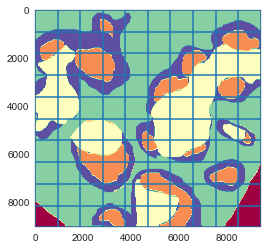

In [85]:
plt.imshow(seg_mask, cmap='Spectral')
plt.hlines(np.linspace(0, seg_mask.shape[0], num=11), 0, seg_mask.shape[1])
plt.vlines(np.linspace(0, seg_mask.shape[1], num=11), 0, seg_mask.shape[0])
plt.xlim(0, seg_mask.shape[1])
plt.ylim(seg_mask.shape[0],0)

In [86]:
y_bounds = np.linspace(0, seg_mask.shape[0], num=21)
x_bounds = np.linspace(0, seg_mask.shape[1], num=21)

In [87]:
tile_ids_arr = np.zeros(seg_mask.shape)
tile_ids = []

b_follicle_count = 0
pals_count = 0
red_pulp_count = 0
marginal_zone_count = 0 

for i in range(1, len(y_bounds)):
    for j in range(1, len(y_bounds)):
        min_x = int(np.round(x_bounds[i - 1]))
        max_x = int(np.round(x_bounds[i]))
        min_y = int(np.round(y_bounds[j - 1]))
        max_y = int(np.round(y_bounds[j]))

        most_freq_id = int(stats.mode(seg_mask[min_y:max_y, min_x:max_x], axis=None)[0])
        tile_ids_arr[min_y:max_y, min_x:max_x] = most_freq_id
        tile_ids.append(most_freq_id)
        
        if most_freq_id == 1:
            b_follicle_count += 1
        elif most_freq_id == 2:
            pals_count += 1
        elif most_freq_id == 3:
            red_pulp_count += 1
        elif most_freq_id == 4:
            marginal_zone_count += 1
        else:
            pass

(9072, 0)

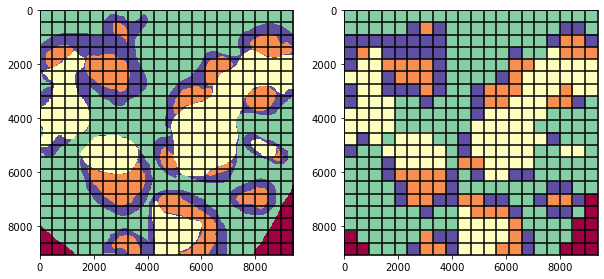

In [11]:
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(10,5))
ax1.imshow(seg_mask, cmap='Spectral')
ax1.hlines(y_bounds, 0, seg_mask.shape[1])
ax1.vlines(x_bounds, 0, seg_mask.shape[0])
ax1.set_xlim(0, seg_mask.shape[1])
ax1.set_ylim(seg_mask.shape[0],0)

ax2.imshow(tile_ids_arr, cmap='Spectral')
ax2.hlines(y_bounds, 0, seg_mask.shape[1])
ax2.vlines(x_bounds, 0, seg_mask.shape[0])
ax2.set_xlim(0, seg_mask.shape[1])
ax2.set_ylim(seg_mask.shape[0],0)


In [12]:
print("B Follicle Tiles ", b_follicle_count)
print("PALS Tiles ", pals_count)
print("Red Pulp Tiles ", red_pulp_count)
print("Marginal Zone Tiles", marginal_zone_count)

B Follicle Tiles  51
PALS Tiles  94
Red Pulp Tiles  174
Marginal Zone Tiles 69


## Generate Tiles

In [217]:
from spatialpower.tissue_generation import assign_labels

In [29]:
adjacency_matrix = np.load('./adj_mat_239_cell_tissue_scaffold_tile.npy')
C = np.load('./C_239_cell_tissue_scaffold_tile.npy')
R = np.load('./R_239_cell_tissue_scaffold_tile.npy')
graph = nx.from_numpy_matrix(adjacency_matrix)

p = np.load('./spleen_data/for_paper/p_bfollicle_balbc1.npy')
H = np.load('./spleen_data/for_paper/H_bfollicle_balbc1.npy')

#n_cell_types = len(cell_type_probabilities)
position_dict = dict()
for i in range(0, C.shape[0]):
    position_dict[i] = C[i, :]

In [222]:
i=0
while i <= b_follicle_count:
    attribute_dict = assign_labels.heuristic_assignment(graph, p, H, 'region', 350, position_dict, 100)
    heuristic_B = build_assignment_matrix(attribute_dict, 27)
    np.save('./spleen_data/for_paper/tiles/239_cell_tiles/image4/B_hueristic_bfollicle_' + str(i) + '.npy', heuristic_B)
    if i % 10 == 0:
        print(i)
    i += 1

0
10
20
30
40
50


In [223]:
p = np.load('./spleen_data/for_paper/p_pals_balbc1.npy')
H = np.load('./spleen_data/for_paper/H_pals_balbc1.npy')


n_cell_types = 27
position_dict = dict()
for i in range(0, C.shape[0]):
    position_dict[i] = C[i, :]

In [224]:
i=0
while i <= pals_count:
    attribute_dict = assign_labels.heuristic_assignment(graph, p, H, 'region', 350, position_dict, 50)
    heuristic_B = build_assignment_matrix(attribute_dict, 27)
    np.save('./spleen_data/for_paper/tiles/239_cell_tiles/image4/B_hueristic_pals_' + str(i) + '.npy', heuristic_B)
    if i % 10 == 0:
        print(i)
    i += 1

0
10
20
30
40
50
60
70
80
90


In [225]:
p = np.load('./spleen_data/for_paper/p_redpulp_balbc1.npy')
H = np.load('./spleen_data/for_paper/H_redpulp_balbc1.npy')

n_cell_types = 27
position_dict = dict()
for i in range(0, C.shape[0]):
    position_dict[i] = C[i, :]

In [226]:
i=0
while i <= red_pulp_count:
    attribute_dict = assign_labels.heuristic_assignment(graph, p, H, 'region', 350, position_dict, 50)
    heuristic_B = build_assignment_matrix(attribute_dict, 27)
    np.save('./spleen_data/for_paper/tiles/239_cell_tiles/image4/B_hueristic_redpulp_' + str(i) + '.npy', heuristic_B)
    if i % 10 == 0:
        print(i)
    i += 1

0
10
20
30
40
50
60
70
80
90
100
110
120
130
140
150
160
170


In [227]:
p = np.load('./spleen_data/for_paper/p_marginalzone_balbc1.npy')
H = np.load('./spleen_data/for_paper/H_marginalzone_balbc1.npy')


n_cell_types =27
position_dict = dict()
for i in range(0, C.shape[0]):
    position_dict[i] = C[i, :]

In [228]:
i=0
while i <= marginal_zone_count:
    attribute_dict = assign_labels.heuristic_assignment(graph, p, H, 'region', 350, position_dict, 50)
    heuristic_B = build_assignment_matrix(attribute_dict, 27)
    np.save('./spleen_data/for_paper/tiles/239_cell_tiles/image4/B_hueristic_marginalzone_' + str(i) + '.npy', heuristic_B)
    if i % 10 == 0:
        print(i)
    i += 1

0
10
20
30
40
50
60


## Stitch tiles

In [229]:
import math
tiles_per_row = 20
tiles_per_col = 20

In [ ]:
y_bounds = np.linspace(0, 350*tiles_per_col, num=21)
x_bounds = np.linspace(0, 350*tiles_per_row, num=21)


In [231]:
#Calculate x/y shifts for each position
shifts = []
C_composite = C.copy()
for i in range(0, len(tile_ids)):
    
    if i > 0:
        horiz_pos = math.floor((i)/tiles_per_col) #returns a 0 indexed position in the row (x adjustment in composite)
        vert_pos = i % tiles_per_row #returns a 0 indexed position in the column (e.g. y adjustment in composite)
        #tile_type = tile_ids[i]
        x_inc = x_bounds[1]
        y_inc = y_bounds[1]

        x_adjustment = horiz_pos * x_inc
        y_adjustment = vert_pos * y_inc

        shifts.append([x_adjustment, y_adjustment])

        C_shift = np.zeros(C.shape)
        C_shift[:, 0] = C[:, 0] + x_adjustment + np.random.rand()
        C_shift[:, 1] = C[:, 1] + y_adjustment + np.random.rand()
        
        C_composite = np.vstack((C_composite, C_shift))
        
        

In [343]:
#Remove the elements of C that are in blank tiles. 
a, = np.where(np.array(tile_ids) == 0)

C_composite_trim = C_composite.copy()
to_delete = []
for tile_id in a:
    temp = [i + 239*tile_id for i in range(0, 239)]
    for t in temp:
        to_delete.append(t)
        
mask = [i for i in range(0, C_composite.shape[0]) if i not in to_delete]

In [349]:
C_composite_trim = C_composite[mask]

In [522]:
from glob import glob

In [523]:
pals_B_arr_names = np.sort(glob('./spleen_data/for_paper/tiles/239_cell_tiles/image4/B_hueristic_pals*'))
bfollicle_B_arr_names = np.sort(glob('./spleen_data/for_paper/tiles/239_cell_tiles/image4/B_hueristic_bfollicle*'))
redpulp_B_arr_names = np.sort(glob('./spleen_data/for_paper/tiles/239_cell_tiles/image4/B_hueristic_redpulp*'))
marginalzone_B_arr_names = np.sort(glob('./spleen_data/for_paper/tiles/239_cell_tiles/image4/B_hueristic_marginalzone*'))

In [524]:
pals_tiles_used = 0
bfollicle_tiles_used = 0
redpulp_tiles_used = 0
marginalzone_tiles_used = 0

for i in range(0, len(tile_ids)):
    
    tile_type = tile_ids[i]
    
    if tile_type == 1:
        arr_name = bfollicle_B_arr_names[bfollicle_tiles_used]
        bfollicle_tiles_used += 1
    elif tile_type == 2:
        arr_name = pals_B_arr_names[pals_tiles_used]
        pals_tiles_used += 1
    elif tile_type == 3:
        arr_name = redpulp_B_arr_names[redpulp_tiles_used]
        redpulp_tiles_used += 1
    elif tile_type == 4:
        arr_name = marginalzone_B_arr_names[marginalzone_tiles_used]
        marginalzone_tiles_used += 1
    else:
        #what should we do about empty tiles...
        #with the graph where blank tiles have been removed, just need to skip them 
        pass
    
    if tile_type != 0:
        if i == 0:
            B_composite = np.load(arr_name)
        else:
            B_composite = np.vstack((B_composite, np.load(arr_name)))
    
    '''else:
        if i == 0:
            B_composite = np.zeros((C.shape[0], 27))
        else:
            B_composite = np.vstack((B_composite,np.zeros((C.shape[0], 27))))'''
    
        
np.save('./spleen_data/for_paper/B_full_image_heuristic_4.npy', B_composite) 
        

### Visualize

In [34]:
C_composite_trim = np.load('./spleen_data/for_paper/C_composite_trim.npy')

In [35]:
type_dict = dict()
for i in range(0, B_composite.shape[0]):

    for j in range(0, B_composite.shape[1]):
        if B_composite[i, j] == 1:
            type_dict[i] = j
            
position_dict = dict()
for i in range(0, C_composite_trim.shape[0]):
    position_dict[i] = C_composite_trim[i, :]

In [36]:
color_list = ["#ffc500","#12ff00","#00e9ff","#005600","#ff3100","#00ff50","#75ff00","#0056ff","#ff0000","#ffafaf","#fff600","#a000ff","#00ffb2","#6f00ff","#ff00fb","#0087ff","#0d00ff","#0024ff","#ff6200","#3e00ff","#d100ff","#00ff81","#00b8ff","#00ffe4","#ff9400","#a6ff00","#ffff00","#000000"]

In [37]:
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import spatialpower.tissue_generation.visualization as viz
from scipy.spatial import Voronoi, voronoi_plot_2d

In [38]:
B_composite = np.load('./spleen_data/for_paper/B_full_image_heuristic_1.npy')

In [39]:
point_list = [position_dict[i] for i in range(0, C_composite_trim.shape[0])]
#point_list = [position_dict[i] for i in range(0, C.shape[0])]
vor = Voronoi(point_list)
regions, vertices = viz.voronoi_finite_polygons_2d(vor)

colors = [color_list[type_dict[i]] for i in range(0, B_composite.shape[0])]
#dim = 300 * 2

#ab = [9408, 9072]
ab=[7000,7000]


In [529]:
vor = Voronoi(point_list)
regions, vertices = viz.voronoi_finite_polygons_2d(vor)
colors = [color_list[type_dict[i]] for i in range(0, B_composite.shape[0])]

0
1000
2000
3000
4000
5000
6000
7000
8000
9000
10000
11000
12000
13000
14000
15000
16000
17000
18000
19000
20000
21000
22000
23000
24000
25000
26000
27000
28000
29000
30000
31000
32000
33000
34000
35000
36000
37000
38000
39000
40000
41000
42000
43000
44000
45000
46000
47000
48000
49000
50000
51000
52000
53000
54000
55000
56000
57000
58000
59000
60000
61000
62000
63000
64000
65000
66000
67000
68000
69000
70000
71000
72000
73000
74000
75000
76000
77000
78000
79000
80000
81000
82000
83000
84000
85000
86000
87000
88000
89000
90000
91000
92000
93000
94000
95000


<Figure size 432x288 with 0 Axes>

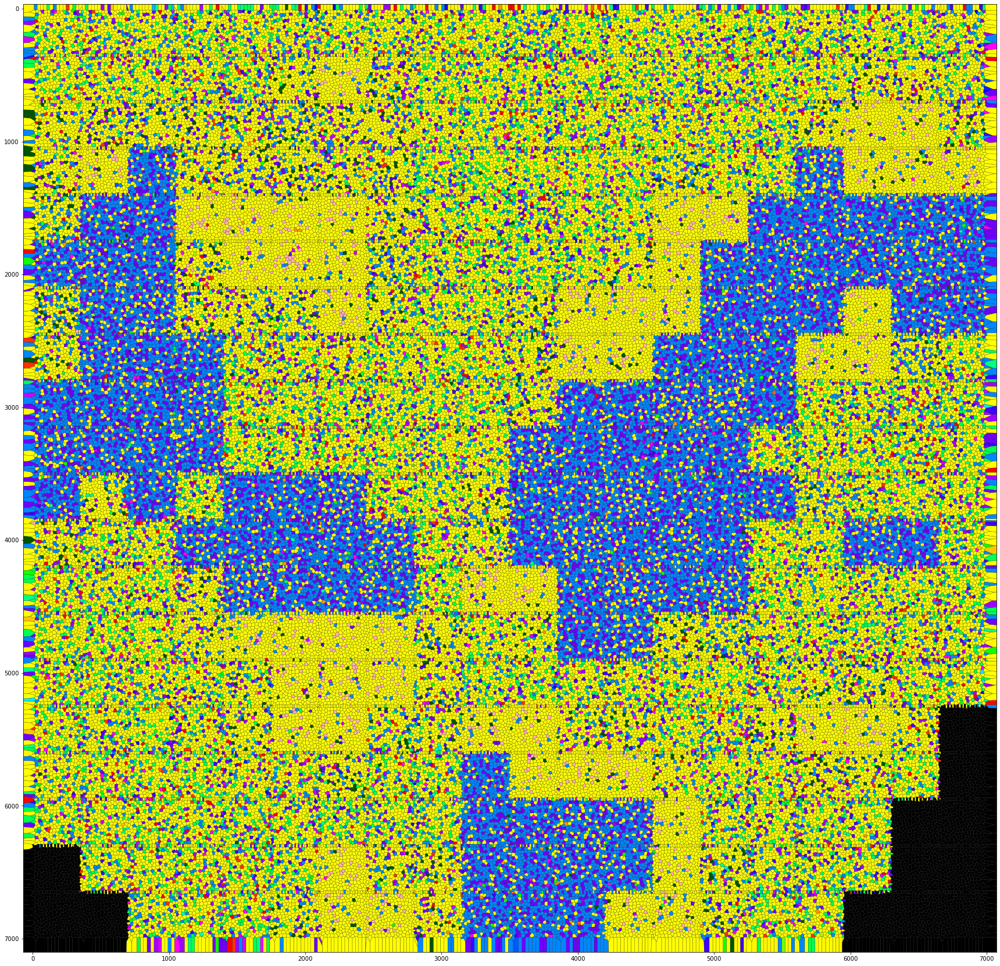

In [62]:
ab = [7000, 7000]
plt.clf()
fig, ax2 = plt.subplots(1,1,figsize=(30,30))

for r in range(0, len(regions)):
    if r % 1000 == 0:
        print(r)
    region = regions[r]
    polygon = vertices[region]
    ax2.fill(*zip(*polygon), alpha=1, facecolor=colors[r], edgecolor = 'k', lw=0.25)
    
ax2.set(xlim=(0 - 0.01*ab[0], ab[0] + 0.01 * ab[0]), ylim=(7100, 0 - 0.01*ab[1]/2))
plt.savefig('./spleen_data/figures/full_composite_thinBorder_239celltiles.png', dpi=500)
plt.show()

<Figure size 432x288 with 0 Axes>

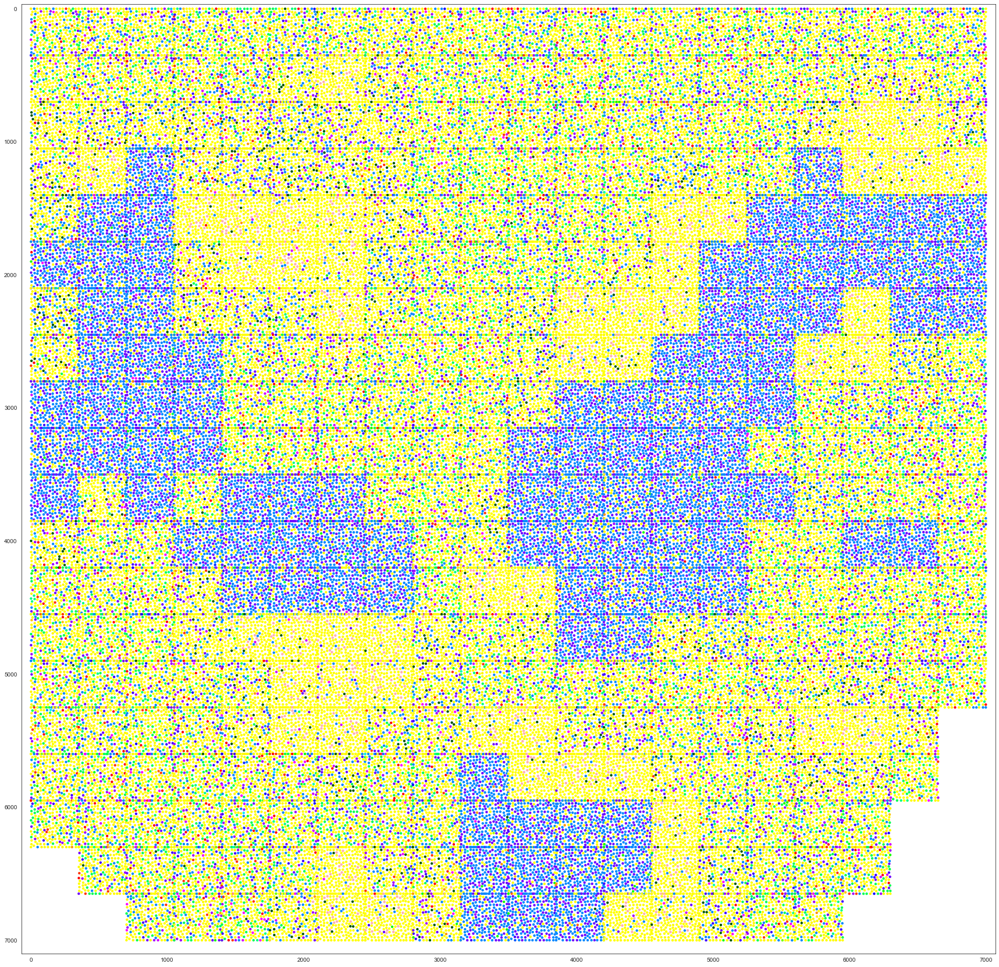

In [40]:
import seaborn as sns
plt.clf()
sns.set_style('white')
fig, ax2 = plt.subplots(1,1,figsize=(30,30))
plt.scatter(np.array(point_list)[:,0], np.array(point_list)[:,1], c=colors, s=11)
ax2.set(xlim=(0 - 0.01*ab[0], ab[0] + 0.01 * ab[0]), ylim=(7100, 0 - 0.01*ab[1]/2))
#plt.savefig('./spleen_data/figures/full_composite_239cell_tiles_scatter.pdf')
plt.show()


In [531]:
np.save('./spleen_data/for_paper/C_composite_trim.npy', C_composite_trim)

## Connect the graphs

In [61]:
adjacency_matrix = np.load('./adj_mat_239_cell_tissue_scaffold_tile.npy')
C = np.load('./C_239_cell_tissue_scaffold_tile.npy')
R = np.load('./R_239_cell_tissue_scaffold_tile.npy')
graph = nx.from_numpy_matrix(adjacency_matrix)

In [29]:
max_x = max(C[:,0])
max_y = max(C[:,1])
buffer = 10 #how close to the border we want to consider
print(max_x, max_y)

350.0 350.0


In [30]:
x_edge_donors, = np.where(C[:, 0] > (max_x - buffer)) #these are the nodes close to the right side that need to be connected to
x_edge_acceptors, = np.where(C[:, 0] < buffer) #these are the nodes close to the left side that need to be connected to


In [31]:
a = np.hstack((x_edge_acceptors.reshape((x_edge_acceptors.shape[0],1)), C[x_edge_acceptors, :]))
a[a[:,2].argsort()] #sort by y position
b = a[a[:,2].argsort()]
sorted_x_edge_acceptors = b[:,0]

a = np.hstack((x_edge_donors.reshape((x_edge_donors.shape[0],1)), C[x_edge_donors, :]))
a[a[:,2].argsort()] #sort by y position
b = a[a[:,2].argsort()]
sorted_x_edge_donors = b[:,0]


In [32]:
y_edge_donors, = np.where(C[:, 1] > (max_y - buffer)) #these are the nodes close to the bottom side that need to be connected to
y_edge_acceptors, = np.where(C[:, 1] < buffer) #these are the nodes close to the top side that need to be connected to

a = np.hstack((y_edge_acceptors.reshape((y_edge_acceptors.shape[0],1)), C[y_edge_acceptors, :]))
a[a[:,1].argsort()] #sort by y position
b = a[a[:,1].argsort()]
sorted_y_edge_acceptors = b[:,0]

a = np.hstack((y_edge_donors.reshape((y_edge_donors.shape[0],1)), C[y_edge_donors, :]))
a[a[:,1].argsort()] #sort by y position
b = a[a[:,1].argsort()]
sorted_y_edge_donors = b[:,0]

In [33]:
x_stitch_dict = dict()
y_stitch_dict = dict()

for i in range(0, sorted_x_edge_donors.shape[0]):
    if i < len(sorted_x_edge_acceptors):
        donor_id = int(sorted_x_edge_donors[i])
        acceptor_id = int(sorted_x_edge_acceptors[i])
    else:
        #the donors list longer than acceptors
        donor_id = int(sorted_x_edge_donors[i])
        acceptor_id = int(sorted_x_edge_acceptors[-1]) #just stick it to the last node
    
    x_stitch_dict[donor_id] = acceptor_id
    
for i in range(0, sorted_y_edge_donors.shape[0]):
    if i < len(sorted_y_edge_acceptors):
        donor_id = int(sorted_y_edge_donors[i])
        acceptor_id = int(sorted_y_edge_acceptors[i])
    else:
        #the donors list longer than acceptors
        donor_id = int(sorted_y_edge_donors[i])
        acceptor_id = int(sorted_y_edge_acceptors[-1]) #just stick it to the last node
    
    y_stitch_dict[donor_id] = acceptor_id

In [58]:
new_graph = graph.copy()

In [63]:
composite_graph = nx.disjoint_union(graph, new_graph)

In [65]:
for i in range(0, 398):
    composite_graph = nx.disjoint_union(composite_graph, new_graph)

In [ ]:
A = nx.to_numpy_matrix(composite_graph)

In [67]:
current_tile_id = 0
for tile_x_index in range(0, 20):
    for tile_y_index in range(0,20):
        if tile_x_index < 19:
            if tile_y_index < 19: 
                for i in sorted_y_edge_donors:
                    y_acceptor = y_stitch_dict[i]
                    source = int(i) + (239 * current_tile_id)
                    target = y_acceptor + (239 * (current_tile_id + 1))
                    composite_graph.add_edge(source, target)

                for i in sorted_x_edge_donors:
                    x_acceptor = x_stitch_dict[i]
                    source = int(i) + (239 * current_tile_id)
                    #target = x_acceptor + (239 * (current_tile_id + 20))
                    target = (x_acceptor + (239 * current_tile_id)) + (239 * 20)
                    composite_graph.add_edge(source, target)
            else:
                # we're in the bottom row, so only stitch horizontally.
                for i in sorted_x_edge_donors:
                    x_acceptor = x_stitch_dict[i]
                    source = int(i) + (239 * current_tile_id)
                    target = (x_acceptor + (239 * current_tile_id)) + (239 * 20)
                    composite_graph.add_edge(source, target)
                
        else:
            #we're in the last column, so only stitch vertically.
            if tile_y_index < 19: 
                for i in sorted_y_edge_donors:
                    y_acceptor = y_stitch_dict[i]
                    source = int(i) + (239 * current_tile_id)
                    target = y_acceptor + (239 * (current_tile_id + 1))
                    composite_graph.add_edge(source, target)
            else:
                #this is the bottom right corner...everything is stitched!
                print("Done!")
           
        current_tile_id += 1
#sorted_y_edge_acceptors.astype(int) + (239 * tile_y_index)

Done!


<Figure size 432x288 with 0 Axes>

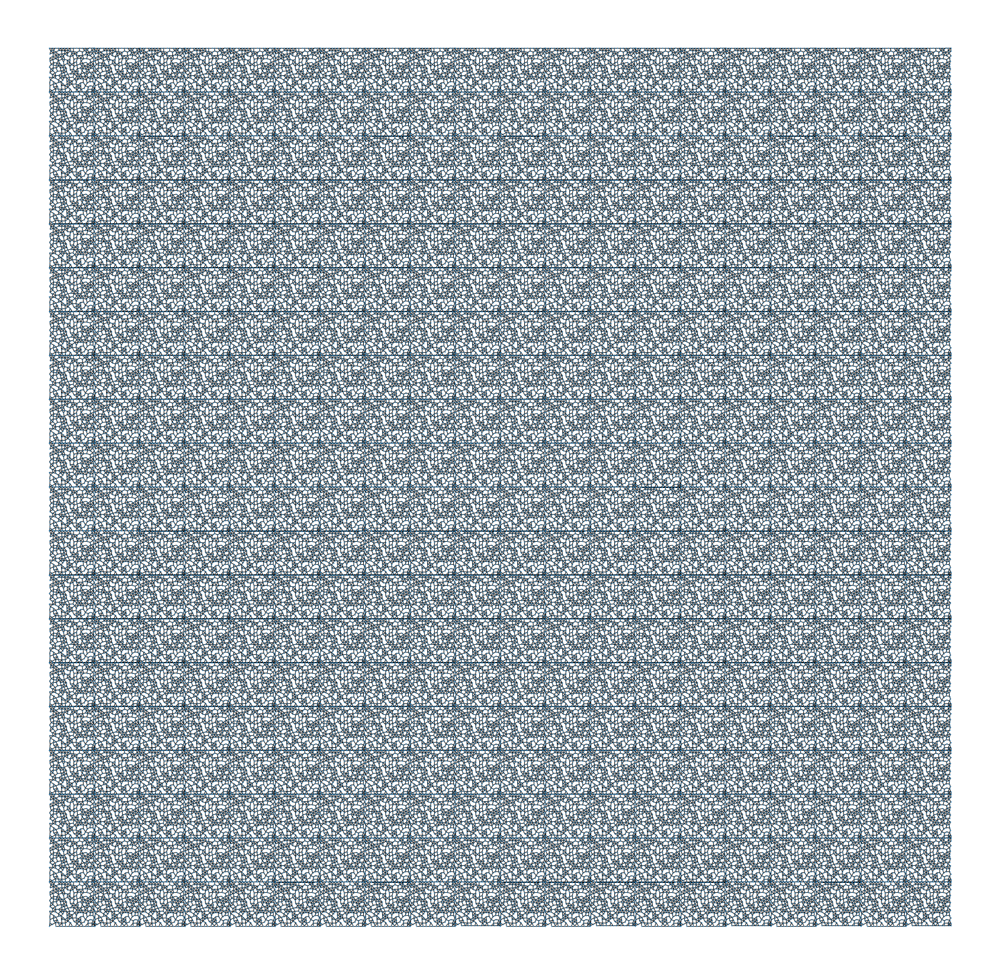

In [69]:
plt.clf()
fig, ax2 = plt.subplots(1,1,figsize=(30,30))
nx.draw(composite_graph, pos=position_dict, node_size=1, ax=ax2)
ax2.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
plt.gca().invert_yaxis()
plt.savefig('./spleen_data/for_paper/stitched_graph.png', dpi=500)

In [71]:
from scipy import sparse

In [295]:
#Remove the nodes of A that are in blank tiles. 
a, = np.where(np.array(tile_ids) == 0)

for tile_id in a:
    #Get the nodes to delete:
    node_ids = [i + 239*tile_id for i in range(0, 239)]
    
    for n in node_ids:
        composite_graph.remove_node(n)

In [299]:
A = nx.to_scipy_sparse_matrix(composite_graph)

In [300]:
sparse.save_npz('./spleen_data/for_paper/stitched_graph_noblank.npz', A)

<Figure size 432x288 with 0 Axes>

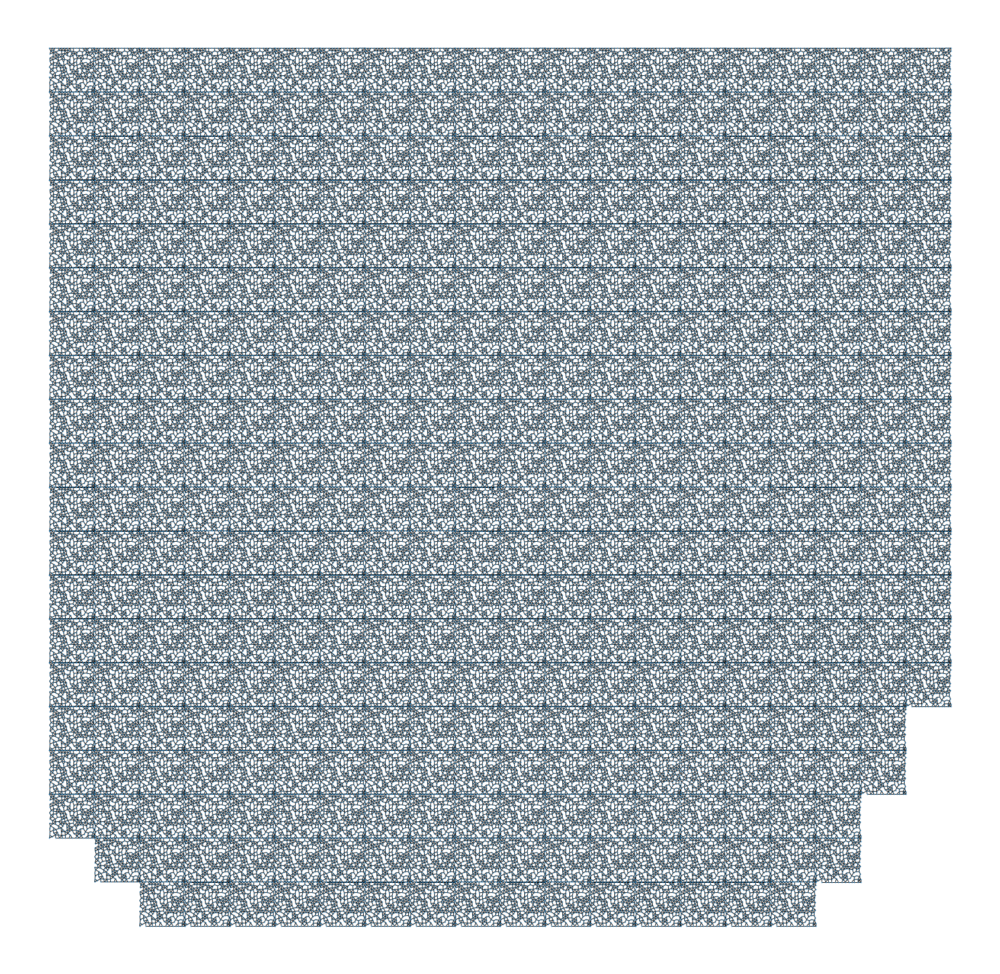

In [298]:
plt.clf()
fig, ax2 = plt.subplots(1,1,figsize=(30,30))
nx.draw(composite_graph, pos=position_dict, node_size=1, ax=ax2)
ax2.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)
plt.gca().invert_yaxis()
#plt.savefig('./spleen_data/for_paper/stitched_graph.png', dpi=500)